# BertViz Interactive Tutorial
### ⚠️ **Note: You do not need to execute any cells.** ⚠️
### **Scroll down for pre-loaded visualizations** 👇👇👇👇👇👇

In [1]:
k = 1

In [2]:
import torch
import matplotlib.pyplot as plt

def plot_attention_vs_attribution(attention_scores: torch.Tensor, attributions: torch.Tensor, index=None):
    """
    Plots a scatter plot to visualize the relationship between attention scores and attributions for self-attention.
    
    Parameters:
    - attention_scores: A 2D tensor (tokens x tokens) containing self-attention scores.
    - attributions: A 2D tensor (tokens x tokens) containing corresponding attributions.
    """
    
    # Flatten the tensors
    attention_scores_flat = attention_scores.flatten()
    attributions_flat = attributions.flatten()

    # Plot the scatter plot
    plt.figure(figsize=(8, 6))
    plt.scatter(attention_scores_flat.numpy(), attributions_flat.numpy(), alpha=0.6, c='blue', edgecolors='w', s=80)
    plt.xlabel("Attention Scores")
    plt.ylabel("Attributions")
    plt.grid(True)
    # plt.show()
    plt.savefig(f"scatter_{index}.png")


In [6]:
prev_mask = torch.ones(12)

for k in range(2, 4):

    # Load model and retrieve attention weights
    import torch

    from bertviz import head_view, model_view
    from transformers import BertTokenizer, BertForSequenceClassification
    import numpy as np

    model_version = '/gpu-data4/dbek/thesis/tuning/UNCASED/batch_32/mnli/seed_42'
    # model_version = f'/gpu-data4/dbek/thesis/pruned_finetuned/UNCASED/batch_32/seed_42/IGSPF/corr/target_None/mnli/balanced_samples_2000/head_mask_{k}'
    mask = np.load(f"/gpu-data4/dbek/thesis/pruning/UNCASED/batch_32/seed_42/IGSPF/corr/target_None/mnli/balanced_samples_2000/head_mask_{k}.npy")
    model = BertForSequenceClassification.from_pretrained(model_version, output_attentions=True)
    tokenizer = BertTokenizer.from_pretrained(model_version)
    # sentence_a = "One of our number will carry out your instructions minutely."
    # sentence_b = "A member of my team will execute your orders with immense precision."
    # inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')

    sentence_a = "It is rainy!"
    inputs = tokenizer.encode_plus(sentence_a, return_tensors='pt')
    
    input_ids = inputs['input_ids']
    token_type_ids = inputs['token_type_ids']
    scores, attention = model(input_ids, token_type_ids=token_type_ids)
    # sentence_b_start = token_type_ids[0].tolist().index(1)
    input_id_list = input_ids[0].tolist() # Batch index 0
    tokens = tokenizer.convert_ids_to_tokens(input_id_list)

    mask = torch.from_numpy(mask)

    layer = 0

    import torch

    def apply_pruning_mask(attention_layer, mask):
        """
        Apply pruning mask to an attention layer.

        Args:
        - attention_layer (torch.Tensor): The attention tensor of shape [1, num_heads, tokens, tokens].
        - mask (torch.Tensor): The mask tensor of shape [num_heads], where 0 indicates a pruned head and 1 indicates a retained head.

        Returns:
        - torch.Tensor: The adjusted attention tensor of shape [1, 12, tokens, tokens], where pruned heads are replaced by zero tensors.
        """
        num_heads = attention_layer.size(1)
        tokens = attention_layer.size(-1)

        # Initialize the final attention tensor with zeros of the required shape
        final_attention = torch.zeros((1, 12, tokens, tokens), device=attention_layer.device)

        # Apply the mask to the attention layer
        current_head = 0
        for i in range(mask.size(0)):
            if mask[i] == 1:
                final_attention[0, i] = attention_layer[0, current_head]
                current_head += 1

        return final_attention

    # Example input mask and attention layer
    mask_layer = mask[layer]
    attention_layer = attention[layer]

    # Apply the pruning mask to the attention layer
    attention_layer = apply_pruning_mask(attention_layer, mask_layer)

    import numpy as np
    import torch
    from captum.attr import LayerConductance
    from captum.attr import visualization as viz
    import matplotlib.pyplot as plt 
    from captum.attr import configure_interpretable_embedding_layer, remove_interpretable_embedding_layer


    # Input text sentence
    # sentence_a = "One of our number will carry out your instructions minutely."
    # sentence_b = "A member of my team will execute your orders with immense precision."
    # inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')

    sentence_a = "It is rainy!"
    inputs = tokenizer.encode_plus(sentence_a, return_tensors='pt')
    
    # Ensure the input tensor is of type LongTensor
    input_ids = inputs['input_ids']
    attention_mask = inputs['attention_mask']

    # Define reference input ids for baseline (all padding tokens except for CLS and SEP)
    ref_input_ids = torch.zeros_like(input_ids)  # pad_token_id == 0 by default for BERT
    ref_input_ids[:, 0] = tokenizer.cls_token_id
    ref_input_ids[:, -1] = tokenizer.sep_token_id

    # Define a custom forward function to return the logits and attention scores of the last layer
    def forward_attention(inputs_embeds, attention_mask):
        outputs = model(inputs_embeds=inputs_embeds, attention_mask=attention_mask)
        return outputs.logits, outputs.attentions[-1]  # Logits and last layer attention scores

    # Configure interpretable embedding layer
    try:
        interpretable_embedding = configure_interpretable_embedding_layer(model, 'bert.embeddings.word_embeddings')

        # Convert input IDs and reference IDs to embeddings
        input_embeddings = interpretable_embedding.indices_to_embeddings(input_ids)
        ref_input_embeddings = interpretable_embedding.indices_to_embeddings(ref_input_ids)

        for i in range(1):
            layer_attn_mat = []
            # Initialize LayerConductance for the last encoder layer of BERT
            layer_conductance = LayerConductance(lambda x: forward_attention(x, attention_mask)[0], model.bert.encoder.layer[layer])

            # Compute attributions with respect to the model's classification logits
            attributions = layer_conductance.attribute(inputs=input_embeddings, baselines=ref_input_embeddings, target=0)
            print(attributions[1].shape)
            layer_attn_mat.append(attributions[1].detach().clone().cpu()) # convert into cpu memory and the delete from cuda to avoid memory leak

            # stack all the layers -> layer x batch x head x tokens x tokens
            layer_attn_mat = torch.cat(layer_attn_mat)


    finally:
        # Remove the interpretable embedding layer to return the model to its original state
        remove_interpretable_embedding_layer(model, interpretable_embedding)


    # Example input mask and attention layer
    layer_attn_mat_layer = layer_attn_mat
    # Apply the pruning mask to the attention layer
    layer_attn_mat_layer = apply_pruning_mask(layer_attn_mat_layer, mask_layer)

    # Compute the difference between the masks
    newly_masked = (mask_layer == 0) & (prev_mask == 1)
    
    # Get the indices where the new mask is 1 and the previous mask was 0
    indices = torch.nonzero(newly_masked).squeeze()
    prev_mask = mask_layer


    scatt_attentions = attention_layer[0][range(12)]
    scatt_attributions = layer_attn_mat_layer[0][range(12)]

    # for index, (att, attr) in enumerate(zip(scatt_attentions, scatt_attributions)):
    #     if index != 1 and index != 3:
    #         continue
    #     plot_attention_vs_attribution(att.detach(), attr.detach(), index)

    # model_view([attention_layer], tokens, sentence_b_start, display_mode="light")
    # model_view([layer_attn_mat_layer*100], tokens, sentence_b_start, display_mode="light")


    # html_model_view = model_view([attention_layer], tokens, sentence_b_start, display_mode="light", html_action='return')

    # with open(f"/home/dbek/src/thesis/thesis-layerconductance-structured-pruning-bert/src/visuals/model_view_attentions_{k}.html", 'w') as file:
    #     file.write(html_model_view.data)

    # html_model_view = model_view([layer_attn_mat_layer*100], tokens, sentence_b_start, display_mode="light", html_action='return')

    # with open(f"/home/dbek/src/thesis/thesis-layerconductance-structured-pruning-bert/src/visuals/model_view_attributions_{k}.html", 'w') as file:
    #     file.write(html_model_view.data)    
    break

AttributeError: 'str' object has no attribute 'size'

In [5]:
def visualize_token2token_scores(scores_mat, x_label_name='Head'):
    fig = plt.figure(figsize=(20, 20))

    for idx, scores in enumerate(scores_mat):
        if idx == 10:
            scores_np = np.array(scores)
            ax = fig.add_subplot(4, 3, idx+1)
            # append the attention weights
            im = ax.imshow(scores, cmap='viridis')

            fontdict = {'fontsize': 10}

            ax.set_xticks(range(len(tokens)))
            ax.set_yticks(range(len(tokens)))

            ax.set_xticklabels(tokens, fontdict=fontdict, rotation=90)
            ax.set_yticklabels(tokens, fontdict=fontdict)
            ax.set_xlabel('{} {}'.format(x_label_name, idx+1))

            fig.colorbar(im, fraction=0.046, pad=0.04)
    plt.tight_layout()
    plt.show()

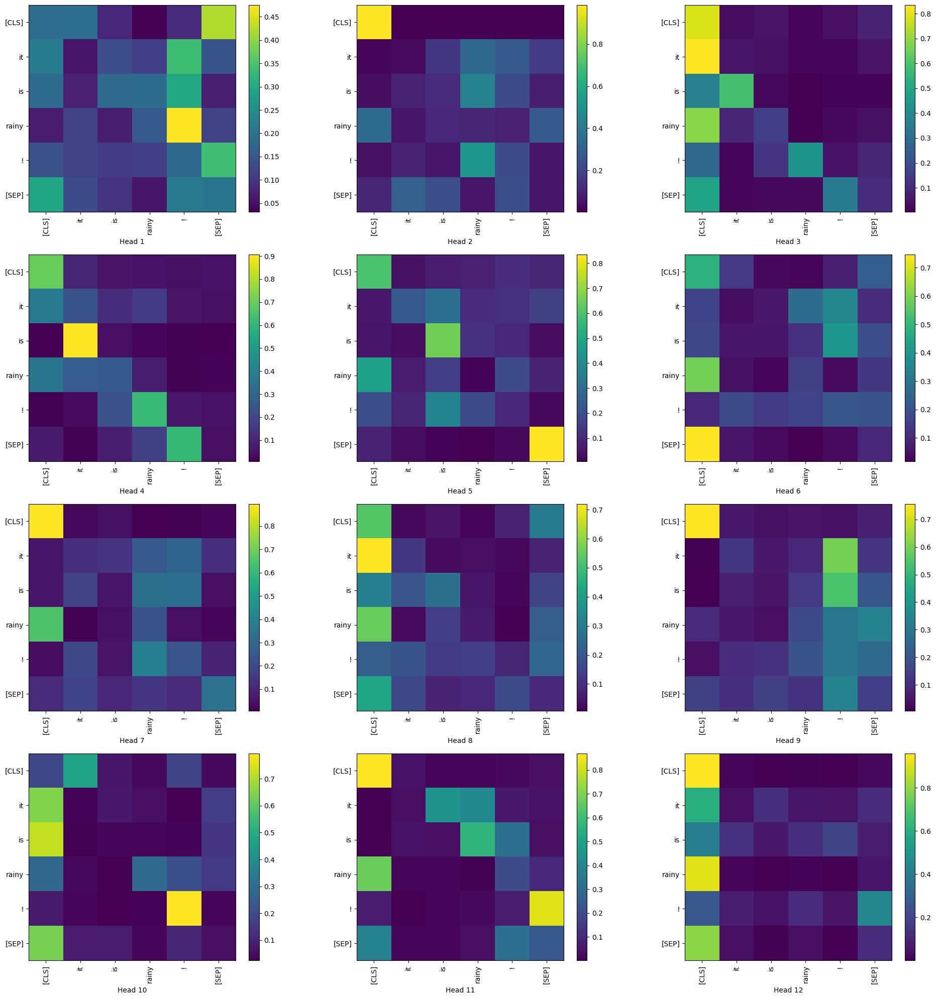

In [20]:
visualize_token2token_scores(attention[layer].squeeze().detach().cpu().numpy())

In [ ]:
def summarize_attributions(attributions):
    attributions = attributions.sum(dim=-1).squeeze(0)
    attributions = attributions / torch.norm(attributions)
    return attributions


In [ ]:
attributions_sum = summarize_attributions(layer_attn_mat)

In [ ]:
# storing couple samples in an array for visualization purposes
start_position_vis = viz.VisualizationDataRecord(
                        attributions_sum,
                        torch.max(torch.softmax(scores[0], dim=0)),
                        torch.argmax(scores),
                        torch.argmax(scores),
                        str(ground_truth_start_ind),
                        attributions_sum.sum(),       
                        input,
                        delta_start)

end_position_vis = viz.VisualizationDataRecord(
                        attributions_end_sum,
                        torch.max(torch.softmax(end_scores[0], dim=0)),
                        torch.argmax(end_scores),
                        torch.argmax(end_scores),
                        str(ground_truth_end_ind),
                        attributions_end_sum.sum(),       
                        all_tokens,
                        delta_end)

print('\033[1m', 'Visualizations For Start Position', '\033[0m')
viz.visualize_text([start_position_vis])


In [229]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 9, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [231]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 7, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [233]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 6, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [238]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")
plt

torch.Size([1, 6, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [242]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 5, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [245]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 3, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 640x480 with 0 Axes>

In [140]:

print(mask)
print(len(attention))
print(attention[0].shape)
print(attention[1].shape)
print(attention[2].shape)
print(attention[3].shape)

tensor([[1., 1., 1., 1., 1., 1., 0., 1., 1., 0., 1., 0.],
        [1., 0., 1., 1., 0., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 0., 1., 1., 1., 0., 0., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 0., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
        [1., 1., 1., 0., 1., 1., 1., 1., 0., 1., 1., 1.],
        [0., 1., 1., 1., 1., 1., 1., 1., 0., 1., 1., 1.],
        [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.]])
12
torch.Size([1, 9, 28, 28])
torch.Size([1, 10, 28, 28])
torch.Size([1, 12, 28, 28])
torch.Size([1, 9, 28, 28])


# Head View
<b>The head view visualizes attention in one or more heads from a single Transformer layer.</b> Each line shows the attention from one token (left) to another (right). Line weight reflects the attention value (ranges from 0 to 1), while line color identifies the attention head. When multiple heads are selected (indicated by the colored tiles at the top), the corresponding  visualizations are overlaid onto one another.  For a more detailed explanation of attention in Transformer models, please refer to the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1).

## Usage
👉 **Hover** over any **token** on the left/right side of the visualization to filter attention from/to that token. <br/>
👉 **Double-click** on any of the **colored tiles** at the top to filter to the corresponding attention head.<br/>
👉 **Single-click** on any of the **colored tiles** to toggle selection of the corresponding attention head. <br/>
👉 **Click** on the **Layer** drop-down to change the model layer (zero-indexed).


In [141]:
print(attention[0].shape)
head_view([attention[0]], tokens, sentence_b_start, )

torch.Size([1, 9, 28, 28])


<IPython.core.display.Javascript object>

# Model View
<b>The model view provides a birds-eye view of attention throughout the entire model</b>. Each cell shows the attention weights for a particular head, indexed by layer (row) and head (column).  The lines in each cell represent the attention from one token (left) to another (right), with line weight proportional to the attention value (ranges from 0 to 1).  For a more detailed explanation, please refer to the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1).

## Usage
👉 **Click** on any **cell** for a detailed view of attention for the associated attention head (or to unselect that cell). <br/>
👉 Then **hover** over any **token** on the left side of detail view to filter the attention from that token.

In [206]:
layer = 0

In [143]:
print(mask[layer])

tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0., 1.])


In [219]:
import torch

def apply_pruning_mask(attention_layer, mask):
    """
    Apply pruning mask to an attention layer.

    Args:
    - attention_layer (torch.Tensor): The attention tensor of shape [1, num_heads, tokens, tokens].
    - mask (torch.Tensor): The mask tensor of shape [num_heads], where 0 indicates a pruned head and 1 indicates a retained head.

    Returns:
    - torch.Tensor: The adjusted attention tensor of shape [1, 12, tokens, tokens], where pruned heads are replaced by zero tensors.
    """
    num_heads = attention_layer.size(1)
    tokens = attention_layer.size(-1)

    # Initialize the final attention tensor with zeros of the required shape
    final_attention = torch.zeros((1, 12, tokens, tokens), device=attention_layer.device)

    # Apply the mask to the attention layer
    current_head = 0
    for i in range(mask.size(0)):
        if mask[i] == 1:
            final_attention[0, i] = attention_layer[0, current_head]
            current_head += 1

    return final_attention

In [220]:
# Example input mask and attention layer
mask_layer = mask[layer]
attention_layer = attention[layer]

# Apply the pruning mask to the attention layer
attention_layer = apply_pruning_mask(attention_layer, mask_layer)

In [191]:
## mask 7
html_model_view = model_view([attention_layer], tokens, sentence_b_start, display_mode="light", html_action='return')

with open(f"/home/dbek/src/thesis/thesis-layerconductance-structured-pruning-bert/src/visuals/model_view_whole_attentions_{k}.html", 'w') as file:
    file.write(html_model_view.data)

In [152]:
## mask 7
print(attention[layer].shape)
html_model_view = model_view([attention[layer]], tokens, sentence_b_start, display_mode="light", html_action='return')

with open(f"/home/dbek/src/thesis/thesis-layerconductance-structured-pruning-bert/src/visuals/model_view_attentions_{k}.html", 'w') as file:
    file.write(html_model_view.data)

torch.Size([1, 11, 28, 28])


In [210]:
## mask 6
print(attention[layer].shape)
model_view([attention[layer]], tokens, sentence_b_start, display_mode="light")
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 9, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
## mask 2
print(attention[layer].shape)
model_view([attention[layer]], tokens, sentence_b_start, display_mode="light")

In [ ]:
## mask 1
print(attention[layer].shape)
model_view([attention[layer]], tokens, sentence_b_start, display_mode="light")

In [221]:
import numpy as np
import torch
from captum.attr import LayerConductance
from captum.attr import visualization as viz
import matplotlib.pyplot as plt 
from captum.attr import configure_interpretable_embedding_layer, remove_interpretable_embedding_layer


# Input text sentence
sentence_a = "One of our number will carry out your instructions minutely."
sentence_b = "A member of my team will execute your orders with immense precision."
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')

# Ensure the input tensor is of type LongTensor
input_ids = inputs['input_ids']
attention_mask = inputs['attention_mask']

# Define reference input ids for baseline (all padding tokens except for CLS and SEP)
ref_input_ids = torch.zeros_like(input_ids)  # pad_token_id == 0 by default for BERT
ref_input_ids[:, 0] = tokenizer.cls_token_id
ref_input_ids[:, -1] = tokenizer.sep_token_id

# Define a custom forward function to return the logits and attention scores of the last layer
def forward_attention(inputs_embeds, attention_mask):
    outputs = model(inputs_embeds=inputs_embeds, attention_mask=attention_mask)
    return outputs.logits, outputs.attentions[-1]  # Logits and last layer attention scores

# Configure interpretable embedding layer
try:
    interpretable_embedding = configure_interpretable_embedding_layer(model, 'bert.embeddings.word_embeddings')

    # Convert input IDs and reference IDs to embeddings
    input_embeddings = interpretable_embedding.indices_to_embeddings(input_ids)
    ref_input_embeddings = interpretable_embedding.indices_to_embeddings(ref_input_ids)

    for i in range(1):
        layer_attn_mat = []
        # Initialize LayerConductance for the last encoder layer of BERT
        layer_conductance = LayerConductance(lambda x: forward_attention(x, attention_mask)[0], model.bert.encoder.layer[layer])

        # Compute attributions with respect to the model's classification logits
        attributions = layer_conductance.attribute(inputs=input_embeddings, baselines=ref_input_embeddings, target=0)
        print(attributions[1].shape)
        layer_attn_mat.append(attributions[1].detach().clone().cpu()) # convert into cpu memory and the delete from cuda to avoid memory leak

        # stack all the layers -> layer x batch x head x tokens x tokens
        layer_attn_mat = torch.cat(layer_attn_mat)


finally:
    # Remove the interpretable embedding layer to return the model to its original state
    remove_interpretable_embedding_layer(model, interpretable_embedding)


torch.Size([1, 7, 28, 28])


In [222]:
# Example input mask and attention layer
layer_attn_mat_layer = layer_attn_mat
print(layer_attn_mat_layer.shape)
# Apply the pruning mask to the attention layer
layer_attn_mat_layer = apply_pruning_mask(layer_attn_mat_layer, mask_layer)

torch.Size([1, 7, 28, 28])


In [194]:
## mask 7
html_model_view = model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light", html_action='return')

with open(f"/home/dbek/src/thesis/thesis-layerconductance-structured-pruning-bert/src/visuals/model_view_whole_attributions_{k}.html", 'w') as file:
    file.write(html_model_view.data)

In [223]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 7, 28, 28])


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

In [ ]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

In [ ]:
## mask 6
print(layer_attn_mat.shape)
model_view([attention_layer], tokens, sentence_b_start, display_mode="light")

model_view([abs(layer_attn_mat_layer)*100], tokens, sentence_b_start, display_mode="light")

In [ ]:
## mask 2
print(layer_attn_mat.shape)
model_view([abs(layer_attn_mat)*100], tokens, sentence_b_start, display_mode="light")

In [201]:
## mask 1
print(layer_attn_mat.shape)
model_view([abs(layer_attn_mat)*10], tokens, sentence_b_start, display_mode="light")

torch.Size([1, 6, 28, 28])


<IPython.core.display.Javascript object>

# Neuron View
<b>The neuron view visualizes the intermediate representations (e.g. query and key vectors) that are used to compute attention.</b> In the collapsed view (initial state), the lines show the attention from each token (left) to every other token (right). In the expanded view, the tool traces the chain of computations that produce these attention weights. For a detailed explanation of the attention mechanism, please refer to the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1).

## Usage
👉 **Hover** over any of the tokens on the left side of the visualization to filter attention from that token.<br/>
👉 Then **click** on the **plus** icon that is revealed when hovering. This exposes the query vectors, key vectors, and other intermediate representations used to compute the attention weights. Each color band represents a single neuron value, where color intensity indicates the magnitude and hue the sign (blue=positive, orange=negative).<br/>
👉 Once in the expanded view, **hover** over any other **token** on the left to see the associated attention computations.<br/>
👉 **Click** on the **Layer** or **Head** drop-downs to change the model layer or head (zero-indexed).


In [29]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

100%|██████████| 440473133/440473133 [01:02<00:00, 7054660.45B/s]
/home/dbek/miniconda3/envs/bertviz/lib/python3.9/site-packages/bertviz/transformers_neuron_view/modeling_utils.py:482: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitH

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [47]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = 'bert'
model_version='/gpu-data4/dbek/thesis/pruned_finetuned/UNCASED/batch_32/seed_42/IGSPF/corr/target_None/mnli/bin/balanced_samples_2000/head_mask_8'
# model_version = '/gpu-data4/dbek/thesis/tuning/UNCASED/batch_32/bin/mnli'

model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased', do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

/home/dbek/miniconda3/envs/bertviz/lib/python3.9/site-packages/bertviz/transformers_neuron_view/modeling_utils.py:482: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_di

RuntimeError: Error(s) in loading state_dict for BertModel:
	size mismatch for bert.encoder.layer.0.attention.self.query.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.0.attention.self.query.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.0.attention.self.key.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.0.attention.self.key.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.0.attention.self.value.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.0.attention.self.value.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.0.attention.output.dense.weight: copying a param with shape torch.Size([768, 64]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.1.attention.self.query.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.1.attention.self.query.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.1.attention.self.key.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.1.attention.self.key.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.1.attention.self.value.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.1.attention.self.value.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.1.attention.output.dense.weight: copying a param with shape torch.Size([768, 192]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.2.attention.self.query.weight: copying a param with shape torch.Size([0, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.2.attention.self.query.bias: copying a param with shape torch.Size([0]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.2.attention.self.key.weight: copying a param with shape torch.Size([0, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.2.attention.self.key.bias: copying a param with shape torch.Size([0]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.2.attention.self.value.weight: copying a param with shape torch.Size([0, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.2.attention.self.value.bias: copying a param with shape torch.Size([0]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.2.attention.output.dense.weight: copying a param with shape torch.Size([768, 0]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.3.attention.self.query.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.3.attention.self.query.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.3.attention.self.key.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.3.attention.self.key.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.3.attention.self.value.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.3.attention.self.value.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.3.attention.output.dense.weight: copying a param with shape torch.Size([768, 64]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.4.attention.self.query.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.4.attention.self.query.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.4.attention.self.key.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.4.attention.self.key.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.4.attention.self.value.weight: copying a param with shape torch.Size([64, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.4.attention.self.value.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.4.attention.output.dense.weight: copying a param with shape torch.Size([768, 64]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.5.attention.self.query.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.5.attention.self.query.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.5.attention.self.key.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.5.attention.self.key.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.5.attention.self.value.weight: copying a param with shape torch.Size([192, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.5.attention.self.value.bias: copying a param with shape torch.Size([192]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.5.attention.output.dense.weight: copying a param with shape torch.Size([768, 192]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.6.attention.self.query.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.6.attention.self.query.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.6.attention.self.key.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.6.attention.self.key.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.6.attention.self.value.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.6.attention.self.value.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.6.attention.output.dense.weight: copying a param with shape torch.Size([768, 256]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.7.attention.self.query.weight: copying a param with shape torch.Size([320, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.7.attention.self.query.bias: copying a param with shape torch.Size([320]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.7.attention.self.key.weight: copying a param with shape torch.Size([320, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.7.attention.self.key.bias: copying a param with shape torch.Size([320]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.7.attention.self.value.weight: copying a param with shape torch.Size([320, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.7.attention.self.value.bias: copying a param with shape torch.Size([320]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.7.attention.output.dense.weight: copying a param with shape torch.Size([768, 320]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.8.attention.self.query.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.8.attention.self.query.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.8.attention.self.key.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.8.attention.self.key.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.8.attention.self.value.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.8.attention.self.value.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.8.attention.output.dense.weight: copying a param with shape torch.Size([768, 128]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.9.attention.self.query.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.9.attention.self.query.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.9.attention.self.key.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.9.attention.self.key.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.9.attention.self.value.weight: copying a param with shape torch.Size([256, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.9.attention.self.value.bias: copying a param with shape torch.Size([256]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.9.attention.output.dense.weight: copying a param with shape torch.Size([768, 256]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.10.attention.self.query.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.10.attention.self.query.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.10.attention.self.key.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.10.attention.self.key.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.10.attention.self.value.weight: copying a param with shape torch.Size([128, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.10.attention.self.value.bias: copying a param with shape torch.Size([128]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.10.attention.output.dense.weight: copying a param with shape torch.Size([768, 128]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.11.attention.self.query.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.11.attention.self.query.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.11.attention.self.key.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.11.attention.self.key.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.11.attention.self.value.weight: copying a param with shape torch.Size([384, 768]) from checkpoint, the shape in current model is torch.Size([768, 768]).
	size mismatch for bert.encoder.layer.11.attention.self.value.bias: copying a param with shape torch.Size([384]) from checkpoint, the shape in current model is torch.Size([768]).
	size mismatch for bert.encoder.layer.11.attention.output.dense.weight: copying a param with shape torch.Size([768, 384]) from checkpoint, the shape in current model is torch.Size([768, 768]).

# Next steps

Visit the [github repository](https://github.com/jessevig/bertviz) for full documentation and additional use cases. Check out the [blog](https://towardsdatascience.com/deconstructing-bert-part-2-visualizing-the-inner-workings-of-attention-60a16d86b5c1) for a deep dive on BertViz and the attention mechanism.